In [1]:
ROOT_DIR = "/home/user/Documents/projects/Metaworld"
%env MUJOCO_GL=egl

import sys
sys.path.append(ROOT_DIR)

import os
import functools
import json
from tqdm import tqdm
import importlib
from dataclasses import dataclass

# scientific
import cv2
import numpy as np
import torch
import pytorch_lightning as pl

# gym
# from gym.spaces import Box
import mujoco
import metaworld
from metaworld import MT1

# plotting
from PIL import Image
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from lightglue import viz2d

# project imports
# from metaworld.envs.mujoco.sawyer_xyz.test_scripted_policies import ALL_ENVS, test_cases_latest_nonoise
# import reset_space
import utils.camera_utils_v2 as cu
import keyframes.env_utils as env_utils
import keyframes.env_renderer as env_renderer
import keyframes.mujoco_utils as mujoco_utils
import keyframes.keyframe_utils as keyframe_utils
import keyframes.pl_modules as pl_modules
import utils.predict_utils as keyframe_predict

import utils.slam_utils as slam_utils
import utils.depth_utils as depth_utils
import utils.match_utils as match_utils
import utils.transform_utils as transform_utils
import utils.inference_utils as inference_utils

import models.extern.mcc_model as mcc_model
import utils.mcc_misc_utils as mcc_misc_utils
import utils.mcc_data_utils as mcc_data_utils
import utils.predict_utils as predict_utils
import utils.vis_utils as vis_utils
from pytorch3d.io.obj_io import load_obj

import keyframes.grasp_pose as grasp_pose


DEVICE = "cuda"


env: MUJOCO_GL=egl


In [2]:
# load feature matching model
config = inference_utils.load_config("feature_matching", "01")
fts_match_ckpt_path = "/home/user/Documents/projects/osil/metaworld/vkzro9co/checkpoints/epoch=34-step=3885.ckpt"
model = pl_modules.PLModel(config["model_args"], config["optimizer_args"])
model = model.load_from_checkpoint(fts_match_ckpt_path)
model.to("cpu")
model.eval();

In [8]:
env_utils.env_names

['assembly-v2',
 'basketball-v2',
 'bin-picking-v2',
 'box-close-v2',
 'button-press-topdown-v2',
 'button-press-topdown-wall-v2',
 'button-press-v2',
 'button-press-wall-v2',
 'coffee-button-v2',
 'coffee-pull-v2',
 'coffee-push-v2',
 'dial-turn-v2',
 'disassemble-v2',
 'door-close-v2',
 'door-lock-v2',
 'door-open-v2',
 'door-unlock-v2',
 'hand-insert-v2',
 'drawer-close-v2',
 'drawer-open-v2',
 'faucet-open-v2',
 'faucet-close-v2',
 'hammer-v2',
 'handle-press-side-v2',
 'handle-press-v2',
 'handle-pull-side-v2',
 'handle-pull-v2',
 'lever-pull-v2',
 'peg-insert-side-v2',
 'pick-place-wall-v2',
 'pick-out-of-hole-v2',
 'reach-v2',
 'push-back-v2',
 'push-v2',
 'pick-place-v2',
 'plate-slide-v2',
 'plate-slide-side-v2',
 'plate-slide-back-v2',
 'plate-slide-back-side-v2',
 'peg-unplug-side-v2',
 'soccer-v2',
 'stick-push-v2',
 'stick-pull-v2',
 'push-wall-v2',
 'reach-wall-v2',
 'shelf-place-v2',
 'sweep-into-v2',
 'sweep-v2',
 'window-open-v2',
 'window-close-v2']

(360, 480, 3) (29, 2)


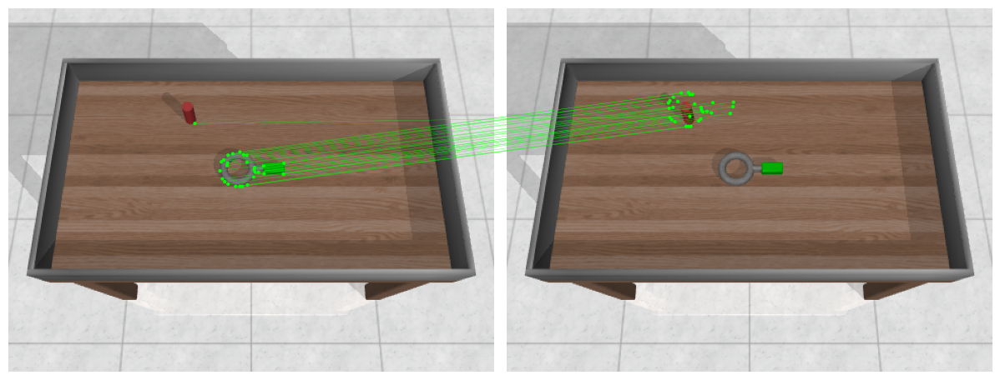

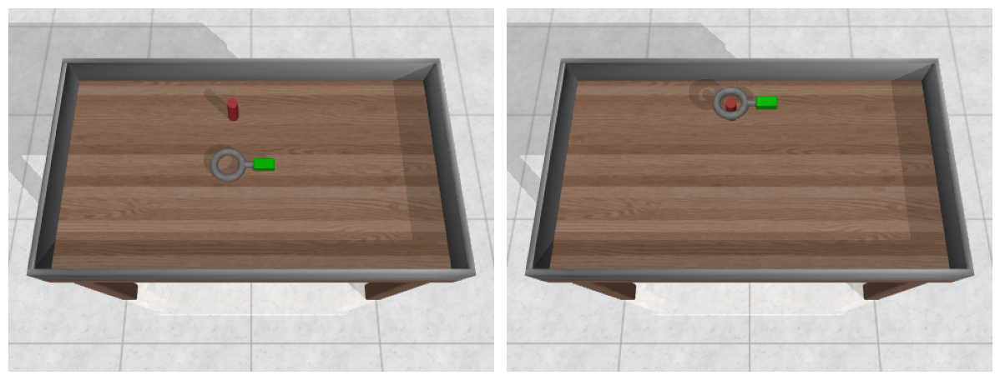

In [13]:
# input data
env_index = 0
img_height, img_width = 360, 480
env, expert_policy, renderer = env_utils.generate_env_and_renderer(env_index, height=img_height, width=img_width)
T_world2pixel = cu.get_camera_transform_matrix(env, "keyframes", img_height, img_width)
T_pixel2world = np.linalg.inv(T_world2pixel)
extractor = slam_utils.get_super_glue_extractor()
# TODO
keyframe_data_0 = keyframe_utils.generate_keyframe_data_with_features(env, renderer, extractor)
keyframe_data_1 = keyframe_utils.generate_keyframe_data_with_features(env, renderer, extractor)
pred_res = inference_utils.predict_feature_movement(model, extractor, env.model.ngeom, keyframe_data_0, keyframe_data_1, T_world2pixel, T_pixel2world)
viz2d.plot_images([keyframe_data_0["img"][0], keyframe_data_0["img"][1]])
print(keyframe_data_1["img"][0].shape, pred_res["kpts"]["kpts_2_0"].numpy().shape)

In [ ]:
print(keyframe_data_1["img"][0].shape, pred_res["kpts"]["kpts_2_0"].numpy().shape)

In [18]:
R_closest, t_closest, t_no_rot_closest, x_center, moving_fts_inter_frame_transform = predict_utils.compute_T(
    pred_res["kpts"]["wpos_kpts_2_0"], 
    pred_res["kpts"]["wpos_kpts_2_1"]
)

In [19]:
# alternative transform for debugging
t_target = np.mean(pred_res["kpts"]["wpos_kpts_2_1"], axis=0) - np.mean(pred_res["kpts"]["wpos_kpts_2_0"], axis=0)

In [8]:
# setup grasp pose estimator
grasp_pose_estimator = grasp_pose.GraspPoseEstimatorMCC(
    seg_any_ckpt_path="/home/user/Documents/projects/osil/sam_vit_h_4b8939.pth",
    mcc_ckpt_path="/home/user/Documents/projects/osil/co3dv2_all_categories.pth"
)

Loading SegAny segmentor...
Loading MCC reconstructor...
Resume checkpoint /home/user/Documents/projects/osil/co3dv2_all_categories.pth
_IncompatibleKeys(missing_keys=[], unexpected_keys=['mask_token'])


In [5]:
img = keyframe_data_1["img"][0]
kpts = pred_res["kpts"]["kpts_2_0"].numpy()
depth = keyframe_data_1["depth"][0]
xyz = depth_utils.pixel_coords_to_world_coords_simple(
    T_pixel2world, 
    depth,
)[:,:3]
# grasp_point_res = grasp_pose_estimator.predict_grasp_point(np.copy(img), np.copy(xyz), np.copy(kpts))

In [24]:
grasp_point = grasp_point_res["grasp_point"]
target_point = moving_fts_inter_frame_transform(grasp_point[None, :])[0]

In [6]:
# visualize
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=xyz[:,0],
            y=xyz[:,1],
            z=xyz[:,2],
            mode="markers",
            marker=dict(
                size=1,
                color="black",                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        # go.Scatter3d(
        #     x=[grasp_point[0], target_point[0]],
        #     y=[grasp_point[1], target_point[1]],
        #     z=[grasp_point[2], target_point[2]],
        #     mode="markers",
        #     marker=dict(
        #         size=2,
        #         # color=xy_c0[2],                # set color to an array/list of desired values
        #         color="red",  # choose a colorscale
        #         opacity=0.8,
        #     ),
        # ),
        go.Scatter3d(
            x=pred_res["kpts"]["wpos_kpts_2_1"][:, 0],
            y=pred_res["kpts"]["wpos_kpts_2_1"][:, 1],
            z=pred_res["kpts"]["wpos_kpts_2_1"][:, 2],
            mode="markers",
            marker=dict(
                size=3,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="green",  # choose a colorscale
                opacity=0.8,
            ),
        ),
        go.Scatter3d(
            x=pred_res["kpts"]["wpos_kpts_2_0"][:, 0],
            y=pred_res["kpts"]["wpos_kpts_2_0"][:, 1],
            z=pred_res["kpts"]["wpos_kpts_2_0"][:, 2],
            mode="markers",
            marker=dict(
                size=3,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="blue",  # choose a colorscale
                opacity=0.8,
            ),
        ),

    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

In [5]:
type(pred_res["kpts"]["kpts_2_0"])

torch.Tensor

In [6]:
img = keyframe_data_1["img"][0]
kpts = pred_res["kpts"]["kpts_2_0"].numpy()
depth = keyframe_data_1["depth"][0]
xyz = depth_utils.pixel_coords_to_world_coords_simple(
    T_pixel2world, 
    depth,
)[:,:3]

In [7]:
seg = grasp_pose_estimator.seg_any_estimator.compute_mask(img, kpts)

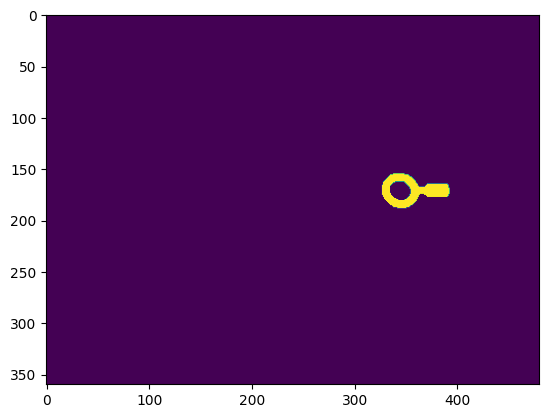

In [8]:
plt.imshow(seg)

In [9]:
grasp_pose_estimator.mcc_reconstructor.set_model_input(img, seg, xyz)

In [10]:
pred_occupy, pred_colors, occupy_threshold, verts, faces, vert_normals, values = grasp_pose_estimator.mcc_reconstructor.reconstruct()

100%|██████████| 256/256 [00:52<00:00,  4.86it/s]


torch.Size([513, 3])


100%|██████████| 1/1 [00:00<00:00, 15.61it/s]


In [22]:
max_pts = 50000
is_occupied = pred_occupy > occupy_threshold
pts = grasp_pose_estimator.mcc_reconstructor.model_input["unseen_xyz"][0][is_occupied, :].cpu().numpy().T
pts_color = pred_colors[is_occupied, :].cpu().numpy()
pts = pts[:,:max_pts]
pts_color = pts_color[:max_pts,:]
print(pts.shape, pts_color.shape)

(3, 4579) (4579, 3)


In [42]:
grasp_pose_estimator.mcc_reconstructor.masked_max_dist

0.1428031372477892

In [23]:
# visualize
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=pts[0],
            y=pts[1],
            z=pts[2],
            mode="markers",
            marker=dict(
                size=1,
                color=pts_color * 255,                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        go.Scatter3d(
            x=grasp_pose_estimator.mcc_reconstructor.model_input["seen_xyz"][grasp_pose_estimator.mcc_reconstructor.model_input["is_valid"]][:,0].cpu().numpy(),
            y=grasp_pose_estimator.mcc_reconstructor.model_input["seen_xyz"][grasp_pose_estimator.mcc_reconstructor.model_input["is_valid"]][:,1].cpu().numpy(),
            z=grasp_pose_estimator.mcc_reconstructor.model_input["seen_xyz"][grasp_pose_estimator.mcc_reconstructor.model_input["is_valid"]][:,2].cpu().numpy(),
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="red",  # choose a colorscale
                opacity=0.8,
            ),
        ),

    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

In [18]:
np.sort(pred_occupy.numpy())[int(0.5 * len(pred_occupy))]

-6.028346

In [11]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=[
    go.Mesh3d(
        # 8 vertices of a cube
        x=verts[:,0],
        y=verts[:,1],
        z=verts[:,2],
        # i, j and k give the vertices of triangles
        i = faces[:, 0],
        j = faces[:, 1],
        k = faces[:, 2],
        name='y',
        showscale=True
    )
])

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

fig.show()

In [53]:
def _check_collision_v2(
    contact_verts: np.ndarray,
    site: str,  # left or right
    occupy_threshold = 5,
):
    n_points_per_dim = 10
    n_sample_points = n_points_per_dim * n_points_per_dim  # gripper_points_sampler.get_num_sample_points()

    n_contact_points = contact_verts.shape[0]
    sample_points = np.zeros((n_sample_points * n_contact_points, 3))

    contact_verts_unnormalized = grasp_pose_estimator.mcc_reconstructor.denormalize(contact_verts)

    # sample gripper points for each contact point
    gripper_pad_width = 0.03
    gripper_depth = 0.006
    gripper_offset = np.array([0,gripper_depth,0])
    if site == "left":
        gripper_offset = -gripper_offset
    for i in range(n_contact_points):
        sample_points[i*n_sample_points:(i+1)*n_sample_points] = grasp_pose.sample_xz_plane_grid(contact_verts_unnormalized[i] + gripper_offset, gripper_pad_width, n_points_per_dim)

    sample_points = grasp_pose_estimator.mcc_reconstructor.normalize(sample_points)
    
    # query model
    pred_occupy, _ = grasp_pose_estimator.mcc_reconstructor.query_model(torch.from_numpy(sample_points))
    pred_occupy = pred_occupy.cpu().numpy()
    
    has_collision = np.zeros(n_contact_points, dtype=bool)
    for i in range(n_contact_points):
        has_collision[i] = np.any(pred_occupy[i*n_sample_points:(i+1)*n_sample_points] > occupy_threshold)
    return has_collision, pred_occupy, sample_points

def _generate_potential_grasp_points(verts: np.ndarray, vert_normals: np.ndarray, occupy_threshold, scale=1.0):
    """
    Args:
        verts: (N, 3)
        vert_normals: (N, 3)
    Returns:
        verts_1_new: (N, 3)
        verts_2_new: (N, 3)
        verts_1: (N, 3)
        verts_2: (N, 3)
        v1_to_v2: (N,) np.ndarray
    """
    target_normal=np.array([0,1,0])
    gripper_max_width = 0.088 * scale
    
    # 1) only consider vertices that are aligned with target_normal
    # NOTE vert_normals seem to be inverted
    angle_1 = grasp_pose.calculate_angle(vert_normals, target_normal)
    angle_2 = grasp_pose.calculate_angle(vert_normals, -target_normal)
    mask_1 = angle_1 < 20
    mask_2 = angle_2 < 20
    verts_1 = verts[mask_1]
    verts_2 = verts[mask_2]

    # TODO Use curvature at vertices as well (curvature should be pos/neg depending on site)
    # => somewhat considered in Mesh - Point Cloud collision checking

    # 2) collision checking
    has_collision_1, _, s = _check_collision_v2(verts_1, occupy_threshold=occupy_threshold, site="left")
    has_collision_2, _, _ = _check_collision_v2(verts_2, occupy_threshold=occupy_threshold, site="right")
    verts_1 = verts_1[~has_collision_1, :]
    verts_2 = verts_2[~has_collision_2, :]

    # 2) find vertices on the opposite side
    v1_to_v2 = -np.ones(verts_1.shape[0], dtype=np.int64)
    v2_indices = np.arange(verts_2.shape[0])
    for i in range(verts_1.shape[0]):
        dist_xyz = verts_2 - verts_1[i]
        dist_xyz_abs = np.abs(dist_xyz)
        mask_x = dist_xyz_abs[:,0] < (0.005 * scale)
        mask_y = np.logical_and(dist_xyz_abs[:,1] < gripper_max_width, dist_xyz[:,1] > 0)
        # due to reconstruction error, we need to allow for some error in z direction
        # TODO ==> another assumption => check implications and scenarios where this might fail
        mask_z = dist_xyz_abs[:,2] < (0.01 * scale)
        mask = np.logical_and(np.logical_and(mask_x, mask_y), mask_z)
        if np.sum(mask) > 0:
            v1_to_v2[i] = v2_indices[mask][0]

    verts_1_new = verts_1[v1_to_v2 != -1]
    verts_2_new = verts_2[v1_to_v2[v1_to_v2 != -1]]
    return verts_1_new, verts_2_new, verts_1, verts_2, v1_to_v2, has_collision_1, has_collision_2, s

In [50]:
occupy_threshold

4.699838018417358

In [54]:
verts_1_new, verts_2_new, _, _, _, has_collision_1, has_collision_2, s = _generate_potential_grasp_points(
    verts, 
    vert_normals, 
    occupy_threshold=occupy_threshold, 
    scale=1/grasp_pose_estimator.mcc_reconstructor.masked_max_dist
)


  0%|          | 0/3 [00:00<?, ?it/s]

100%|██████████| 4/4 [00:00<00:00,  4.94it/s]


In [55]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=[
    go.Mesh3d(
        # 8 vertices of a cube
        x=verts[:,0],
        y=verts[:,1],
        z=verts[:,2],
        # i, j and k give the vertices of triangles
        i = faces[:, 0],
        j = faces[:, 1],
        k = faces[:, 2],
        name='y',
        showscale=True
    ),
    go.Scatter3d(
        x=s[:,0],
        y=s[:,1],
        z=s[:,2],
    )
])

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

fig.show()

In [52]:
has_collision_2

array([False, False, False, False,  True, False,  True,  True, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False,  True,  True, False,  True, False, False,
        True,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False])

In [44]:
verts_1_new

array([], shape=(0, 3), dtype=float32)

In [12]:
scale = 1.0

target_normal=np.array([0,1,0])
gripper_max_width = 0.088 * scale

# 1) only consider vertices that are aligned with target_normal
angle_1 = grasp_pose.calculate_angle(vert_normals, target_normal)
angle_2 = grasp_pose.calculate_angle(vert_normals, -target_normal)
mask_1 = angle_1 < 20
mask_2 = angle_2 < 20
verts_1 = verts[mask_1]
verts_2 = verts[mask_2]

# TODO Use curvature at vertices as well (curvature should be pos/neg depending on site)
# => somewhat considered in Mesh - Point Cloud collision checking



In [13]:
verts_1.shape

(110, 3)

In [14]:
# 2) collision checking
has_collision_1, _, _ = grasp_pose_estimator._check_collision_v2(verts_1)
has_collision_2, _, _ = grasp_pose_estimator._check_collision_v2(verts_2)


ValueError: operands could not be broadcast together with shapes (30,30) (3,) 

In [ ]:
verts_1 = verts_1[~has_collision_1, :]
verts_2 = verts_2[~has_collision_2, :]

In [ ]:
self._log("Computing MCC...")
self.
self._log("Generating potential grasp points...")
self._log("Collision check for potential grasp points...")
has_collision, pred_occupy, sample_points = self._check_collision(verts_1_new, verts_2_new, occupy_threshold)
self._log("Selecting grasp points closes to center of moving object...")
grasp_point = self._compute_grasp_point(verts_1_new, verts_2_new, has_collision)
return grasp_point

Computing mask...


Computing MCC...


100%|██████████| 256/256 [00:52<00:00,  4.91it/s]


torch.Size([487, 3])


100%|██████████| 1/1 [00:00<00:00, 15.27it/s]


Generating potential grasp points...
Collision check for potential grasp points...


100%|██████████| 2/2 [00:00<00:00,  5.79it/s]

Selecting grasp points closes to center of moving object...


ValueError: attempt to get argmin of an empty sequence

## Old

In [2]:
"""
1) Load point cloud
2) Reconstruct surface
"""

'\n1) Load point cloud\n2) Reconstruct surface\n'

In [38]:
importlib.reload(mcc_data_utils)

<module 'utils.mcc_data_utils' from '/home/user/Documents/projects/Metaworld/utils/mcc_data_utils.py'>

In [2]:
out_folder = "/home/user/Documents/projects/Metaworld/keyframes/test_data"
unseen_xyz = np.load(f'{out_folder}/seg_assembly.npy')
unseen_xyz = np.load(f'{out_folder}/assembly_unseen_xyz.npy')
pred_occupy = np.load(f'{out_folder}/assembly_pred_occupy.npy')
pred_color = np.load(f'{out_folder}/assembly_pred_color.npy')

normalized_seen_xyz = np.load(f'{out_folder}/assembly_seen_xyz.npy')
seen_rgb = np.load(f'{out_folder}/assembly_seen_rgb.npy')
is_valid = np.load(f'{out_folder}/assembly_is_valid.npy')
is_seen = np.load(f'{out_folder}/assembly_is_seen.npy')

In [3]:
seg = np.load(f'{out_folder}/seg_assembly.npy')
img = np.load(f'{out_folder}/img_assembly.npy')
xyz = np.load(f'{out_folder}/xyz_assembly.npy')
masked_mean, masked_max_dist = mcc_data_utils.compute_masked_mean_and_max_dist(img, xyz, seg)

In [41]:
max_pts = 50000
is_occupied = pred_occupy > 5.0
pts = unseen_xyz[is_occupied, :].T
pts_color = pred_color[is_occupied, :]
pts = pts[:,:max_pts]
pts_color = pts_color[:max_pts,:]
print(pts.shape, pts_color.shape)

(3, 7468) (7468, 3)


In [42]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=pts[0],
            y=pts[1],
            z=pts[2],
            mode="markers",
            marker=dict(
                size=1,
                color=pts_color * 255,                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        go.Scatter3d(
            x=normalized_seen_xyz[is_valid][:,0],
            y=normalized_seen_xyz[is_valid][:,1],
            z=normalized_seen_xyz[is_valid][:,2],
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="red",  # choose a colorscale
                opacity=0.8,
            ),
        ),

    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)


In [8]:
from skimage import measure
import viewer.viewer as awesome_viewer 
from ipywidgets import HTML, Output
import pythreejs as py3

In [9]:
importlib.reload(awesome_viewer)

<module 'viewer.viewer' from '/home/user/Documents/projects/Metaworld/viewer/viewer.py'>

In [13]:
occupy_threshold = 5
verts, faces, vert_normals, values = measure.marching_cubes(-pred_occupy.reshape(80,80,80), level=-occupy_threshold)
verts = verts - 80/2
verts *= (np.max(unseen_xyz) - np.min(unseen_xyz)) / 80

In [19]:
view_width = 800
view_height = 800
camera = py3.PerspectiveCamera(
    position=[0, 0, 5], 
    up=[0, 1, 0], 
    aspect=view_width / view_height,
    children=[py3.DirectionalLight(color='white', position=[3, 5, 1], intensity=0.5)]
)
camera_control = py3.OrbitControls(controlling=camera)
# camera_control.enableRotate = False
scene = py3.Scene(children=[camera, py3.AmbientLight(color='#777777')])
renderer = py3.Renderer(
    camera=camera,
    scene=scene,
    width=view_width, height=view_height,
    controls=[camera_control],
    antialias=True,
    alpha=True
)

In [20]:
# ball = py3.SphereBufferGeometry(radius=0.1)
# scene.add(ball)

out = Output(layout={'border': '1px solid black'})
m1 = awesome_viewer.BasicMesh(V=verts, T=faces, out=out, flat_shading=True)
scene.add(m1.mesh)
m1.mesh.geometry.exec_three_obj_method('computeVertexNormals')
helper = py3.VertexNormalsHelper(m1.mesh, 0.1, "black")
scene.add(helper)

In [21]:
display(renderer)

Renderer(camera=PerspectiveCamera(children=(DirectionalLight(color='white', intensity=0.5, matrixWorldNeedsUpd…

In [22]:
import numpy as np

def calculate_angle(a, b):
    # Normalize vectors
    a_normalized = np.linalg.norm(a, axis=1)
    b_normalized = np.linalg.norm(b)
    
    # Calculate dot product
    dot_product = np.dot(a, b)
    
    # Calculate cosine similarity
    cosine_similarity = dot_product / (a_normalized * b_normalized)
    
    # Calculate angle in radians
    angle_radians = np.arccos(cosine_similarity)
    
    # Convert angle to degrees
    angle_degrees = np.degrees(angle_radians)
    
    return angle_degrees


def generate_potential_grasp_points(verts, vert_normals, scale=1.0):
    target_normal=np.array([0,1,0])
    gripper_max_width = 0.088 * scale
    
    # 1) only consider vertices that are aligned with target_normal
    angle_1 = calculate_angle(vert_normals, target_normal)
    angle_2 = calculate_angle(vert_normals, -target_normal)
    mask_1 = angle_1 < 20
    mask_2 = angle_2 < 20
    verts_1 = verts[mask_1]
    verts_2 = verts[mask_2]

    # TODO Use curvature at vertices as well (curvature should be pos/neg depending on site)
    # => somewhat considered in Mesh - Point Cloud collision checking

    # 2) find vertices on the opposite side
    v1_to_v2 = -np.ones(verts_1.shape[0], dtype=np.int64)
    v2_indices = np.arange(verts_2.shape[0])
    for i in range(verts_1.shape[0]):
        dist_xyz = verts_2 - verts_1[i]
        dist_xyz_abs = np.abs(dist_xyz)
        mask_x = dist_xyz_abs[:,0] < (0.005 * scale)
        mask_y = np.logical_and(dist_xyz_abs[:,1] < gripper_max_width, dist_xyz[:,1] > 0)
        mask_z = dist_xyz_abs[:,2] < (0.01 * scale)
        mask = np.logical_and(np.logical_and(mask_x, mask_y), mask_z)
        if np.sum(mask) > 0:
            v1_to_v2[i] = v2_indices[mask][0]

    verts_1_new = verts_1[v1_to_v2 != -1]
    verts_2_new = verts_2[v1_to_v2[v1_to_v2 != -1]]
    return verts_1_new, verts_2_new, verts_1, verts_2, v1_to_v2

In [117]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=pts[0],
            y=pts[1],
            z=pts[2],
            mode="markers",
            marker=dict(
                size=1,
                color=pts_color * 255,                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        go.Scatter3d(
            x=verts_1_new[:,0],
            y=verts_1_new[:,1],
            z=verts_1_new[:,2],
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="green",  # choose a colorscale
                opacity=0.8,
            ),
        ),
        go.Scatter3d(
            x=verts_2_new[:,0],
            y=verts_2_new[:,1],
            z=verts_2_new[:,2],
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="red",  # choose a colorscale
                opacity=0.8,
            ),
        ),

    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

In [24]:
import utils.mcc_misc_utils as mcc_misc_utils

In [25]:
importlib.reload(mcc_misc_utils)

<module 'utils.mcc_misc_utils' from '/home/user/Documents/projects/Metaworld/utils/mcc_misc_utils.py'>

In [26]:
fts_match_ckpt_path = "/home/user/Documents/projects/osil/co3dv2_all_categories.pth"
model = mcc_misc_utils.load_model_from_ckpt(fts_match_ckpt_path)

Resume checkpoint /home/user/Documents/projects/osil/co3dv2_all_categories.pth
_IncompatibleKeys(missing_keys=[], unexpected_keys=['mask_token'])


In [56]:
import keyframes.gripper_sample_points as gripper_sample_points
importlib.reload(gripper_sample_points)

<module 'keyframes.gripper_sample_points' from '/home/user/Documents/projects/Metaworld/keyframes/gripper_sample_points.py'>

In [132]:
def query_model(model, query_points, seen_xyz, seen_rgb, is_valid, device="cuda"):
    is_seen = torch.zeros((query_points.shape[0]), device=device).bool()
    unseen_rgb = torch.zeros_like(query_points.float(), device=device)
    model_input = {
        "seen_xyz": seen_xyz[None, ...],
        "seen_rgb": seen_rgb[None, ...],
        "unseen_xyz": query_points[None, ...].float(),  # query points
        "unseen_rgb": unseen_rgb[None, ...],  # only used for loss => not needed for inference
        "is_seen": is_seen[None, ...],  # only used for loss => not needed for inference
        "is_valid": is_valid[None, ...],  # only used for loss => not needed for inference
    }
    for k, v in model_input.items():
        print(k, v.shape, v.dtype)
    model.to(device)
    for k, v in model_input.items():
        model_input[k] = v.to(device)
    pred_occupy, pred_colors = mcc_misc_utils.predict_mcc(model, model_input)
    return pred_occupy, pred_colors


def sample_xz_plane_grid(center_pt, grid_size, n_points_per_dim):
    """ Sample grid of points in xz plane
    Args:
        center_pt: np.ndarray (3)
        grid_size: float
        n_points_per_dim: int
    """
    x = np.linspace(center_pt[0] - grid_size/2, center_pt[0] + grid_size/2, n_points_per_dim)
    z = np.linspace(center_pt[2] - grid_size/2, center_pt[2] + grid_size/2, n_points_per_dim)
    x, z = np.meshgrid(x, z)
    y = np.ones_like(x) * center_pt[1]
    grid = np.stack([x, y, z], axis=-1)
    return grid.reshape(-1, 3)


def check_collision(
    contact_verts_1: np.ndarray, 
    contact_verts_2: np.ndarray,

    # model and model input
    model: torch.nn.Module, 
    normalized_seen_xyz: torch.Tensor, # NOTE these are the coordinates the model has been queried with before
    seen_rgb: torch.Tensor, 
    is_valid: torch.Tensor,

    # data normalization 
    mean: float, 
    max_dist: float, 

    # other params
    occupy_threshold = 5, 
    device = "cuda"
):
    """ Check if gripper collides with object if gripper is placed at contact_verts_1/contact_verts_2
    Args:
        contact_verts_1: np.ndarray (n_contact_points, 3)
        contact_verts_2: np.ndarray (n_contact_points, 3)
        model: torch.nn.Module
        seen_xyz: torch.Tensor (n_seen_points, 3)
        seen_rgb: torch.Tensor (n_seen_points, 3)
        is_valid: torch.Tensor (n_seen_points)
        mean: float
        max_dist: float
        occupy_threshold: float
        device: str
    """
    assert contact_verts_1.shape == contact_verts_2.shape

    # gripper sampler
    gripper_points_sampler = gripper_sample_points.GripperSampler(cell_size=0.025)

    n_points_per_dim = 10
    n_sample_points = 2*n_points_per_dim * n_points_per_dim  # gripper_points_sampler.get_num_sample_points()

    n_contact_points = contact_verts_1.shape[0]
    sample_points = np.zeros((n_sample_points * n_contact_points, 3))

    contact_verts_1_unnormalized = mcc_data_utils.unnormalize_xyz_basic(contact_verts_1, mean, max_dist)
    contact_verts_2_unnormalized = mcc_data_utils.unnormalize_xyz_basic(contact_verts_2, mean, max_dist)

    # sample gripper points for each contact point
    for i in range(n_contact_points):
        verts_pair = np.vstack([contact_verts_1_unnormalized[i], contact_verts_2_unnormalized[i]])
        # offset = verts_pair[0] + (verts_pair[1] - verts_pair[0]) / 2 # + np.array([0,0,-0.015])
        # pad_dist = verts_pair[1,1] - verts_pair[0,1] + 0.000
        # sample_points[i*n_sample_points:(i+1)*n_sample_points] = gripper_points_sampler.sample(pad_dist, offset)[:, :3]
        gripper_offset = np.array([0,0.0005,0])
        sample_left = sample_xz_plane_grid(verts_pair[0] - gripper_offset, 0.01, n_points_per_dim)
        sample_right = sample_xz_plane_grid(verts_pair[1] + gripper_offset, 0.01, n_points_per_dim)
        sample_points[i*n_sample_points:(i+1)*n_sample_points] = np.concatenate([sample_left, sample_right], axis=0)

    sample_points = mcc_data_utils.normalize_xyz_basic(sample_points, mean, max_dist)
    
    # query model
    pred_occupy, _ = query_model(model, torch.from_numpy(sample_points), normalized_seen_xyz, seen_rgb, is_valid, device=device)
    pred_occupy = pred_occupy.cpu().numpy()[0]
    
    has_collision = np.zeros(n_contact_points, dtype=bool)
    for i in range(n_contact_points):
        has_collision[i] = np.any(pred_occupy[i*n_sample_points:(i+1)*n_sample_points] > occupy_threshold)
    return has_collision, pred_occupy, sample_points

In [133]:
verts_1_new, verts_2_new, verts_1, verts_2, v1_to_v2  = generate_potential_grasp_points(verts, vert_normals, scale=1/masked_max_dist)
has_collision, pred_occupy, sample_points = check_collision(
    verts_1_new, verts_2_new, 
    model, 
    torch.from_numpy(normalized_seen_xyz), torch.from_numpy(seen_rgb), torch.from_numpy(is_valid), 
    masked_mean, masked_max_dist, 
    occupy_threshold=5,
    device="cuda"
)

seen_xyz torch.Size([1, 112, 112, 3]) torch.float32
seen_rgb torch.Size([1, 3, 800, 800]) torch.float32
unseen_xyz torch.Size([1, 12600, 3]) torch.float32
unseen_rgb torch.Size([1, 12600, 3]) torch.float32
is_seen torch.Size([1, 12600]) torch.bool
is_valid torch.Size([1, 112, 112]) torch.bool


  0%|          | 0/7 [00:00<?, ?it/s]

100%|██████████| 7/7 [00:01<00:00,  5.21it/s]


In [118]:
sample_points.shape

(6300, 3)

In [134]:
has_collision

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True, False, False,
       False,  True,  True,  True,  True,  True,  True,  True,  True])

In [135]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=pts[0],
            y=pts[1],
            z=pts[2],
            mode="markers",
            marker=dict(
                size=1,
                color=pts_color * 255,                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        go.Scatter3d(
            x=verts_1_new[~has_collision,0],
            y=verts_1_new[~has_collision,1],
            z=verts_1_new[~has_collision,2],
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="green",  # choose a colorscale
                opacity=0.8,
            ),
        ),
        go.Scatter3d(
            x=verts_2_new[~has_collision,0],
            y=verts_2_new[~has_collision,1],
            z=verts_2_new[~has_collision,2],
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="red",  # choose a colorscale
                opacity=0.8,
            ),
        ),
        # go.Scatter3d(
        #     x=sample_points[:,0],
        #     y=sample_points[:,1],
        #     z=sample_points[:,2],
        #     mode="markers",
        #     marker=dict(
        #         size=2,
        #         # color=xy_c0[2],                # set color to an array/list of desired values
        #         color="blue",  # choose a colorscale
        #         opacity=0.8,
        #     ),
        # ),

    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

In [68]:
importlib.reload(mcc_misc_utils)

<module 'utils.mcc_misc_utils' from '/home/user/Documents/projects/Metaworld/utils/mcc_misc_utils.py'>

## Gripper Sample Points

In [23]:
import igl
import pyquaternion as pyq

In [24]:
eGripperBase_path = "/home/user/Documents/projects/Metaworld/keyframes/test_data/eGripperBase.obj"
v_eGripperBase, _, n_eGripperBase, f_eGripperBase, _, _ = igl.read_obj(eGripperBase_path)

In [106]:
def scatter3d(pts_list):
    fig = go.Figure(
        data=[
            go.Scatter3d(
                x=pts[:,0],
                y=pts[:,1],
                z=pts[:,2],
                mode="markers",
                marker=dict(
                    size=2,
                    # color=xy_c0[2],                # set color to an array/list of desired values
                    color="red",  # choose a colorscale
                    opacity=0.8,
                ),
            )
            for pts in pts_list
        ]
    )

    fig.update_layout(
        autosize=True,
        width=800,
        height=600,
        # scene_aspectmode='cube'
        scene_aspectmode='data'
    )
    return fig


In [109]:
n_assembly_ring.shape

(0, 0)

In [110]:
assembly_ring_path = "/home/user/Documents/projects/Metaworld/keyframes/test_data/assembly_peg_ring.obj"
v_assembly_ring, _, n_assembly_ring, f_assembly_ring, _, _ = igl.read_obj(assembly_ring_path)
scatter3d([v_assembly_ring])

In [25]:
v_eGripperBase.shape

(6693, 3)

In [26]:
v_eGripperBase

array([[-0.012032, -0.046034,  0.039   ],
       [-0.012367,  0.045966,  0.03775 ],
       [-0.012367, -0.046034,  0.03775 ],
       ...,
       [ 0.033813,  0.022043,  0.      ],
       [ 0.035961,  0.018521,  0.      ],
       [ 0.037517,  0.014695,  0.      ]])

In [27]:

fig = go.Figure(
    data=[
        go.Scatter3d(
            x=v_eGripperBase[:,0],
            y=v_eGripperBase[:,1],
            z=v_eGripperBase[:,2],
            mode="markers",
            marker=dict(
                size=1,
                color="black",                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    scene_aspectmode='data'
)

In [28]:
def qpos_to_T(quat, pos):
    rot = pyq.Quaternion(quat).rotation_matrix
    T = np.eye(4)
    T[:3,:3] = rot
    T[:3,3] = pos
    return T

class Base3dNode:

    def __init__(self, pos=np.array([0,0,0]), quat=np.array([1,0,0,0])):
        if type(pos) != np.ndarray:
            pos = np.array(pos)
        self.quat = quat
        self.pos = pos
        self.parent_T_node = qpos_to_T(quat, pos)
        self.world_T_node = None
        self.type = "base"

    def forward_T(self, world_T_parent):
        self.world_T_node = world_T_parent @ self.parent_T_node

class Body3dNode(Base3dNode):

    def __init__(self, pos=np.array([0,0,0]), quat=np.array([1,0,0,0])):
        super().__init__(pos, quat=quat)
        if type(pos) != np.ndarray:
            pos = np.array(pos)
        self.pos = pos
        self.children = []
        self.type = "body"

    def add_child(self, child):
        self.children.append(child)

    def forward_T(self, world_T_parent):
        super().forward_T(world_T_parent)
        for child in self.children:
            child.forward_T(self.world_T_node)

class Leaf3dNode(Base3dNode):

    def __init__(self, pos=np.array([0,0,0]), quat=np.array([1,0,0,0])):
        super().__init__(pos, quat=quat)
        self.type = "leaf"

    def create_surface_grid(self, cell_size: float):
        raise NotImplementedError

class BoxNode(Leaf3dNode):

    def __init__(self, sx_half, sy_half, sz_half, pos=np.array([0,0,0])):
        super().__init__(pos)
        self.sx = 2*sx_half
        self.sy = 2*sy_half
        self.sz = 2*sz_half
        self.v = self.create_box_vertices(self.sx, self.sy, self.sz)
        # NOTE faces are not triangles
        self.faces = self.create_box_faces()
        self.type = "box"

    def create_surface_grid(self, cell_size: float):
        grid = []
        for v in self.v:
            grid.append(v)
        for face in self.faces:
            v0, v1, v2, v3 = face
            p0, p1, p2, p3 = self.v[v0], self.v[v1], self.v[v2], self.v[v3]
            min_x = min(p0[0], p1[0], p2[0], p3[0])
            max_x = max(p0[0], p1[0], p2[0], p3[0])
            min_y = min(p0[1], p1[1], p2[1], p3[1])
            max_y = max(p0[1], p1[1], p2[1], p3[1])
            min_z = min(p0[2], p1[2], p2[2], p3[2])
            max_z = max(p0[2], p1[2], p2[2], p3[2])

            nx = max(int(np.ceil((max_x - min_x) / cell_size)), 1)
            ny = max(int(np.ceil((max_y - min_y) / cell_size)), 1)
            nz = max(int(np.ceil((max_z - min_z) / cell_size)), 1)
            
            for ix, x in enumerate(np.linspace(min_x, max_x, nx)):
                ix_is_extrema = ix == 0 or ix == nx - 1
                for iy, y in enumerate(np.linspace(min_y, max_y, ny)):
                    iy_is_extrema = iy == 0 or iy == ny - 1
                    for iz, z in enumerate(np.linspace(min_z, max_z, nz)):
                        iz_is_extrema = iz == 0 or iz == nz - 1
                        if ix_is_extrema and iy_is_extrema and iz_is_extrema:
                            continue
                        grid.append(np.array([x, y, z]))
        return np.vstack(grid)

    def create_box_vertices(self, sx, sy, sz):
        vertices = np.array([
            [-sx/2, -sy/2, -sz/2],  # vertex 0
            [sx/2, -sy/2, -sz/2],   # vertex 1
            [sx/2, sy/2, -sz/2],    # vertex 2
            [-sx/2, sy/2, -sz/2],   # vertex 3
            [-sx/2, -sy/2, sz/2],   # vertex 4
            [sx/2, -sy/2, sz/2],    # vertex 5
            [sx/2, sy/2, sz/2],     # vertex 6
            [-sx/2, sy/2, sz/2]     # vertex 7
        ])
        return vertices

    def create_box_faces(self):
        faces = np.array([
            [0, 1, 2, 3],  # face 0
            [1, 5, 6, 2],  # face 1
            [5, 4, 7, 6],  # face 2
            [4, 0, 3, 7],  # face 3
            [3, 2, 6, 7],  # face 4
            [0, 4, 5, 1]   # face 5
        ])
        return faces

class MeshNode(Leaf3dNode):

    def __init__(self, v, f, n, pos=np.array([0,0,0]), quat=np.array([1,0,0,0])):
        super().__init__(pos, quat=quat)
        self.v = v
        self.f = f
        self.n = n
        self.type = "mesh"

    def create_surface_grid(self, cell_size: float):
        return self.v

In [34]:


gripper_base_box_sizes_half = (np.max(v_eGripperBase, axis=0) - np.min(v_eGripperBase, axis=0)) / 2
gripper_base_box_pos = [0,0,gripper_base_box_sizes_half[2]*2]
print(gripper_base_box_sizes_half)

q1 = pyq.Quaternion(axis=[1, 0, 0], angle=np.pi) # Rotate 180 about X
q2 = pyq.Quaternion(axis=[0, 0, 1], angle=np.pi / 2) # Rotate 90 about Z
q3 = q1 * q2
right_hand = Body3dNode([0, 0, 0.0245], quat=q1.elements)

# gripper base
# eGripperBase = MeshNode(v_eGripperBase, f_eGripperBase, n_eGripperBase, [0, 0, 0.03])#, quat=[np.cos(np.pi/2),np.sin(np.pi/2),0,0])
# right_hand.add_child(eGripperBase)
gripper_base = BoxNode(*gripper_base_box_sizes_half, gripper_base_box_pos)
right_hand.add_child(gripper_base)

# TODO why is the hand wrongly oriented in the original xml?
hand = Body3dNode(pos=[0,0,0.12], quat=[-1,0,1,0])# [np.cos(np.pi/4),0,np.sin(np.pi/4),0])
right_hand.add_child(hand)

# rail
#rail = BoxNode(0.005, 0.055, 0.005, [-0.05, 0, 0])
#hand.add_child(rail)

# rightpad
rightpad_geom = BoxNode(0.045, 0.003, 0.015, [0, -0.05+0.003, 0])
hand.add_child(rightpad_geom)
# rightclaw = Body3dNode([0, -0.05, 0])
# hand.add_child(rightclaw)
# TODO what does it stand for?
# rightclaw_it = BoxNode(0.045, 0.003, 0.015, [0, 0, 0])
# rightpad = Body3dNode([0, 0.003, 0])  # TODO why shift??
# rightclaw.add_child(rightpad)
# rightpad_geom = BoxNode(0.045, 0.003, 0.015, [0, -0.05+0.003, 0])
# rightpad.add_child(rightpad_geom)

leftpad_geom = BoxNode(0.045, 0.003, 0.015, [0, 0.05-0.003, 0])
hand.add_child(leftpad_geom)
# leftclaw = Body3dNode([0, 0.05, 0])
# # leftclaw_it = BoxNode(0.045, 0.003, 0.015, [0, 0, 0])
# leftpad = Body3dNode([0, -0.003, 0])
# leftpad_geom = BoxNode(0.045, 0.003, 0.015, [0, 0, 0])

# right_hand.add_child(eGripperBase)
# right_hand.add_child(hand)
# hand.add_child(rail)
# hand.add_child(leftclaw)
# # rightclaw.add_child(rightclaw_it)
# # leftclaw.add_child(leftclaw_it)
# leftclaw.add_child(leftpad)
# leftpad.add_child(leftpad_geom)



[0.032959 0.052758 0.026689]


In [80]:
def contruct_gripper(pad_dist = 0.088, offset = np.zeros(3)):
    """
    NOTE
    - z-pos of lower gripper area: 0.0
    - total height of gripper: 0.09 (pad height) + 0.054 (gripper_base height) - 0.005 (overlap) = 0.139
    - max gripper width: 0.1 (max outer distance between left and right pad) - 2 * 0.006 (pad thickness) = 0.088
    """
    gripper_total_height = 0.139
    pad_dist_max = 0.088
    assert pad_dist <= pad_dist_max, f"pad_dist must be less than {pad_dist_max}"

    right_hand_quat = pyq.Quaternion(axis=[1, 0, 0], angle=np.pi) # Rotate 180 about X
    # translate z by 0.026 such that z-pos of upper gripper is at 0.0
    right_hand = Body3dNode(np.array([0, 0, 0.026 + gripper_total_height]) + offset, quat=right_hand_quat.elements)

    # gripper base
    # z-pos of upper box area (gripper_base and pad overlap by 0.005): 0.027 + 0.053 = 0.08
    # z-pos of lower box area: 0.053 - 0.027 = 0.026
    gripper_base = BoxNode(0.033, 0.053, 0.027, [0, 0, 0.053])
    right_hand.add_child(gripper_base)

    # container of pads
    # z-pos of lower box area (note that gripper is rotated about X by 180 degrees): 0.12 - 0.045 = 0.075
    hand = Body3dNode(pos=[0,0,0.12], quat=[-1,0,1,0])  # [np.cos(np.pi/4),0,np.sin(np.pi/4),0])
    right_hand.add_child(hand)

    # rightpad
    y_offset = pad_dist / 2 + 0.003  # if pad_dist == pad_dist_max, then y_offset == 0.047 == 0.05 - 0.003
    rightpad = BoxNode(0.045, 0.003, 0.015, [0, -y_offset, 0])
    hand.add_child(rightpad)

    # leftpad
    leftpad = BoxNode(0.045, 0.003, 0.015, [0, y_offset, 0])
    hand.add_child(leftpad)

    return right_hand

In [81]:
gripper_base_box_pos

[0, 0, 0.053377999999999995]

In [66]:
0.026689 + 0.053377999999999995

0.080067

In [64]:
gripper_base_box_sizes_half

array([0.032959, 0.052758, 0.026689])

In [82]:
def sample_box_vertices(root, cell_size: float):
    if root.type == "box" or root.type == "mesh":
        verts = root.create_surface_grid(cell_size)
        verts = np.hstack([verts, np.ones((verts.shape[0], 1))])
        verts = root.world_T_node @ verts.T
        verts = verts.T
        return verts
    elif root.type == "body":
        verts = []
        for child in root.children:
            verts.extend(sample_box_vertices(child, cell_size))
        return np.vstack(verts)

In [204]:
print(verts_1_new.shape)

(63, 3)


In [205]:
verts_pair_index = 50
verts_pair = np.vstack([verts_1_new[verts_pair_index], verts_2_new[verts_pair_index]])
verts_pair_unnormlised = unnormalize_xyz(verts_pair, masked_mean, masked_max_dist)
offset = verts_pair_unnormlised[0] + (verts_pair_unnormlised[1] - verts_pair_unnormlised[0]) / 2 + np.array([0,0,-0.015])
pad_dist = verts_pair_unnormlised[1,1] - verts_pair_unnormlised[0,1] + 0.003

In [196]:
verts_1_new[verts_pair_index]

array([-0.29625002, -0.47663963, -0.09875   ], dtype=float32)

In [201]:
verts_pair

array([[-0.29625002, -0.47663963, -0.09875   ],
       [-0.27156252, -0.17491667, -0.0246875 ]], dtype=float32)

In [202]:
verts_pair_unnormlised

array([[0.16027151, 0.44592   , 0.01797439],
       [0.16352813, 0.48572132, 0.02774423]], dtype=float32)

In [185]:
pad_dist

0.03980133

In [206]:
right_hand = contruct_gripper(pad_dist=pad_dist, offset=offset)
right_hand.forward_T(np.eye(4))
surface_verts = sample_box_vertices(right_hand, 0.025)
surface_verts_normalised = normalize_xyz(surface_verts[:,:3], masked_mean, masked_max_dist)
#surface_verts[:,:2] -= np.mean(surface_verts[:,:2], axis=0)
#surface_verts[:,2] -= np.min(surface_verts[:,2])

In [129]:
surface_verts.shape

(102, 4)

In [78]:
surface_verts.shape

(102, 4)

In [168]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=surface_verts_normalised[:,0],
            y=surface_verts_normalised[:,1],
            z=surface_verts_normalised[:,2],
            mode="markers",
            marker=dict(
                size=4,
                color="black",                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    scene_aspectmode='data'
)

In [207]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=pts[0],
            y=pts[1],
            z=pts[2],
            mode="markers",
            marker=dict(
                size=1,
                color=pts_color * 255,                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        go.Scatter3d(
            x=normalized_seen_xyz[is_valid][:,0],
            y=normalized_seen_xyz[is_valid][:,1],
            z=normalized_seen_xyz[is_valid][:,2],
            mode="markers",
            marker=dict(
                size=2,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="red",  # choose a colorscale
                opacity=0.8,
            ),
        ),
        go.Scatter3d(
            x=surface_verts_normalised[:,0],
            y=surface_verts_normalised[:,1],
            z=surface_verts_normalised[:,2],
            mode="markers",
            marker=dict(
                size=4,
                color="black",                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
        go.Scatter3d(
            x=[verts_pair[0,0], verts_pair[1,0]],
            y=[verts_pair[0,1], verts_pair[1,1]],
            z=[verts_pair[0,2], verts_pair[1,2]],
            mode="markers",
            marker=dict(
                size=3,
                # color=xy_c0[2],                # set color to an array/list of desired values
                color="pink",  # choose a colorscale
                opacity=0.8,
            ),
        ),
    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    # scene_aspectmode='cube'
    scene_aspectmode='data'
)

In [61]:
def get_grasp_center_T_gripper():
    """
    NOTE
    - assumes that the gripper xy is centered at the origin and z starts at 0
    """
    grasp_center_T_gripper = np.eye(4)
    grasp_center_T_gripper[:3,3] = [0, 0, -0.015]
    return grasp_center_T_gripper

def transform_points(T, pts):
    pts = np.hstack([pts, np.ones((pts.shape[0], 1))])
    pts = T @ pts.T
    pts = pts.T
    return pts[:,:3]

In [47]:
surface_verts.shape

(102, 4)

In [62]:
surface_verts_grasp = transform_points(get_grasp_center_T_gripper(), surface_verts[:,:3])

In [63]:
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=surface_verts_grasp[:,0],
            y=surface_verts_grasp[:,1],
            z=surface_verts_grasp[:,2],
            mode="markers",
            marker=dict(
                size=4,
                color="black",                # set color to an array/list of desired values
                #colorscale="Viridis",  # choose a colorscale
                opacity=1.0,
            ),
        ),
    ]
)

fig.update_layout(
    autosize=True,
    width=800,
    height=600,
    scene_aspectmode='data'
)

In [42]:
hand.forward_T(np.eye(4))

In [43]:
leftpad.world_T_node

array([[1.   , 0.   , 0.   , 0.   ],
       [0.   , 1.   , 0.   , 0.047],
       [0.   , 0.   , 1.   , 0.   ],
       [0.   , 0.   , 0.   , 1.   ]])

In [26]:
np.min(v_eGripperBase, axis=0)

array([-0.024407, -0.052792, -0.002516])

In [27]:
np.max(v_eGripperBase, axis=0)

array([0.041511, 0.052724, 0.050862])